<a href="https://colab.research.google.com/github/pren1/VAST-Vtuber-Augmented-Sound-Archive/blob/master/VAST_data_preparation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Data download

In [1]:
!mkdir audio
!cd audio/

mkdir: cannot create directory ‘audio’: File exists


In [2]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime → "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

Mon May  4 02:53:18 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.64.00    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [3]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('To enable a high-RAM runtime, select the Runtime → "Change runtime type"')
  print('menu, and then select High-RAM in the Runtime shape dropdown. Then, ')
  print('re-execute this cell.')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 27.4 gigabytes of available RAM

You are using a high-RAM runtime!


In [4]:
!pip3 install --upgrade youtube-dl

Requirement already up-to-date: youtube-dl in /usr/local/lib/python3.6/dist-packages (2020.5.3)


In [5]:
!youtube-dl --extract-audio https://www.youtube.com/playlist?list=PL9jli3ZqRhJCNo1UKOFz9rPZ7A5M5MSml -o "/content/audio/%(title)s.%(ext)s"

[youtube:playlist] PL9jli3ZqRhJCNo1UKOFz9rPZ7A5M5MSml: Downloading webpage
[download] Downloading playlist: 兎田ぺこら ３D配信
[youtube:playlist] playlist 兎田ぺこら ３D配信: Downloading 3 videos
[download] Downloading video 1 of 3
[youtube] euPeRrN2Tco: Downloading webpage
[download] Destination: /content/audio/【#兎田ぺこら3D】兎田ぺこら3Dお披露目会ぺこ！【ホロライブ_兎田ぺこら】.webm
[download] 100% of 62.33MiB in 00:02
[ffmpeg] Destination: /content/audio/【#兎田ぺこら3D】兎田ぺこら3Dお披露目会ぺこ！【ホロライブ_兎田ぺこら】.opus
Deleting original file /content/audio/【#兎田ぺこら3D】兎田ぺこら3Dお披露目会ぺこ！【ホロライブ_兎田ぺこら】.webm (pass -k to keep)
[download] Downloading video 2 of 3
[youtube] 1vm6s_Joa5Y: Downloading webpage
[download] Destination: /content/audio/【#兎田ぺこら生誕祭】お誕生日だし3Dでいっぱい動いてみんなでお祝いぺこ！【ホロライブ_兎田ぺこら】.webm
[download] 100% of 64.25MiB in 00:02
[ffmpeg] Destination: /content/audio/【#兎田ぺこら生誕祭】お誕生日だし3Dでいっぱい動いてみんなでお祝いぺこ！【ホロライブ_兎田ぺこら】.opus
Deleting original file /content/audio/【#兎田ぺこら生誕祭】お誕生日だし3Dでいっぱい動いてみんなでお祝いぺこ！【ホロライブ_兎田ぺこら】.webm (pass -k to keep)
[download] Downloading v

In [0]:
import os
import pprint
def files_in_target_folder(path, extension=".opus"):
	# obtain all file paths in the target folder
	res_files=[]
	for file in os.listdir(path):
		if file.endswith(extension):
			res_files.append(file)
	return res_files

In [7]:
total_files = files_in_target_folder('/content/audio')
pprint.pprint(total_files)

['【#うさみやぺこた】罰ゲームあり！？３Dコラボでガチンコ勝負ぺこ！！！【ホロライブ_兎田ぺこら】.opus',
 '【#兎田ぺこら3D】兎田ぺこら3Dお披露目会ぺこ！【ホロライブ_兎田ぺこら】.opus',
 '【#兎田ぺこら生誕祭】お誕生日だし3Dでいっぱい動いてみんなでお祝いぺこ！【ホロライブ_兎田ぺこら】.opus']


# Spleeter

In [8]:
!pip install spleeter-gpu
!pip install pyvad

In [0]:
from spleeter.separator import Separator
from IPython.display import Audio
import IPython
import numpy as np
# Use audio loader explicitly for loading audio waveform :
from spleeter.audio.adapter import get_default_audio_adapter
import pdb
from tqdm import tqdm
import matplotlib.pyplot as plt
import numpy as np
from pyvad import vad, split

In [0]:
audio_path = f'audio/{total_files[1]}'
start_point = 48000*90
sample_rate = 48000
window_size = 48000 * 1
padding_length = 48000
building_length = start_point + window_size*60*5 # Process 10 seconds data in total

In [0]:
# Using embedded configuration.
separator = Separator('spleeter:2stems')
audio_loader = get_default_audio_adapter()

In [0]:
def stereoToMono(audiodata):
	'turn 2d array to 1d'
	return np.array(audiodata[:, 0] / 2 + audiodata[:, 1] / 2)

def interval_to_info(interval_seq):
  'extract interval from array'
  res = []
  start = 0
  in_interval = False
  for (index, label) in zip(range(len(interval_seq)), interval_seq):
    if label >= 1 and not in_interval:
      res.append(np.asarray([start, index]))
      in_interval = True
    if label == 0 and in_interval:
      start = index
      in_interval = False
  if not in_interval:
    res.append(np.asarray([start, len(interval_seq)]))
  return np.asarray(res), Dur_info(np.asarray(res), len(interval_seq))

def Dur_info(current_interval_info, whole_length):
  'info about position during the interval'
  during_turn_interval = []
  for index in range(len(current_interval_info)):
    if index == 0:
      continue
    if current_interval_info[index][0] == current_interval_info[index][1]:
      continue
    during_turn_interval.append(np.asarray([current_interval_info[index-1][1], current_interval_info[index][0]]))
  if current_interval_info[-1][1] != whole_length:
    'In case it ends with an interval'
    during_turn_interval.append(np.asarray([current_interval_info[-1][1], whole_length]))
  return during_turn_interval

In [0]:
'load file'
waveform, _ = audio_loader.load(audio_path, sample_rate=sample_rate)

# Split BGM and vocals

In [14]:
vocal_res = []
accompan_res = []

for split_waveform_index in tqdm(range(start_point, building_length, window_size)):
	# Perform the separation :
	clipped_waveform = waveform[split_waveform_index:min(split_waveform_index + window_size, len(waveform))]
	'add padding zeros to each waveform'
	zero_padded_waveform = np.zeros((clipped_waveform.shape[0] + padding_length*2, clipped_waveform.shape[1]))
	zero_padded_waveform[padding_length:-padding_length] = clipped_waveform
	'we may also use the extra data'
	if split_waveform_index-padding_length >= 0 and split_waveform_index + window_size + padding_length < len(waveform):
		zero_padded_waveform[:padding_length] = waveform[split_waveform_index-padding_length:split_waveform_index]
		zero_padded_waveform[-padding_length:] = waveform[split_waveform_index + window_size: split_waveform_index + window_size + padding_length]

	'sperate using spleeter'
	prediction = separator.separate(zero_padded_waveform)
	'clip padded part, throw them away'
	prediction['vocals'] = prediction['vocals'][padding_length: -padding_length]
	prediction['accompaniment'] = prediction['accompaniment'][padding_length: -padding_length]
	'merge results together'
	vocal_res.extend(prediction['vocals'])
	accompan_res.extend(prediction['accompaniment'])

  0%|          | 0/300 [00:00<?, ?it/s]

INFO:tensorflow:Using config: {'_model_dir': 'pretrained_models/2stems', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': gpu_options {
  per_process_gpu_memory_fraction: 0.7
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_experimental_max_worker_delay_secs': None, '_session_creation_timeout_secs': 7200, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x7ff3817fc978>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Apply unet for vocals_spectrogram
Instructions for updating:
If using Keras pass *_co

100%|██████████| 300/300 [00:15<00:00, 19.52it/s]


# Perform VAD

In [0]:
'Turn to Mono'
vocal_res = stereoToMono(np.asarray(vocal_res))
vocal_res = np.clip(vocal_res, -1, 1)
mode_2 = vad(vocal_res, fs=sample_rate, fs_vad=sample_rate, hop_length=10, vad_mode=2)
bet_info, dur_info = interval_to_info(mode_2)

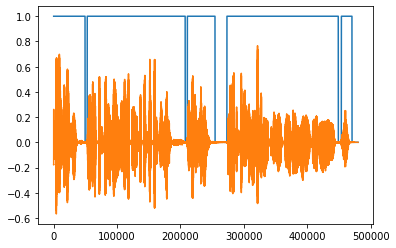

In [16]:
plt.plot(mode_2[-sample_rate * 10:])
plt.plot(vocal_res[-sample_rate * 10:])
plt.show()

In [0]:
def rolling_window(array, window):
    'Obtain the stddev of the array'
    half_window_size = window//2
    res = []
    for index in range(len(array)):
      current_slice = array[max(index - half_window_size, 0):min(index + half_window_size, len(array))]
      res.append(np.std(current_slice))
    return np.asarray(res)

def front_clip(array, threshold):
  'clip std array from front'
  for i in range(len(array)):
    if array[i] < threshold:
      pass
    else:
      return True, i
  return False, -1

def end_clip(array, threshold):
  'clip std array from end'
  for i in range(len(array)):
    if array[~i] < threshold:
      pass
    else:
      return True, i
  return False, -1

# Splitted vocals

In [0]:
threshold = 0.008
std_window_size = 960

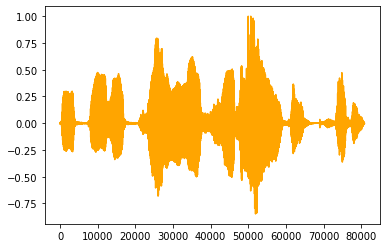

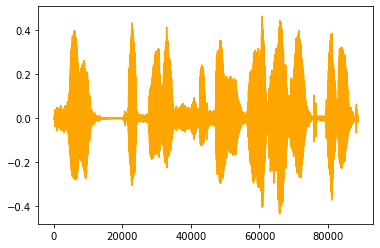

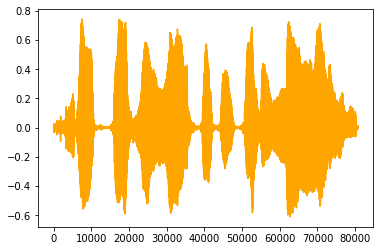

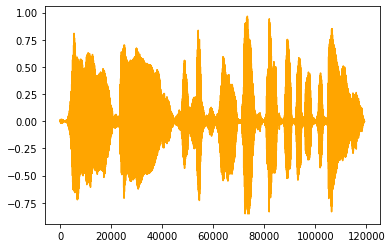

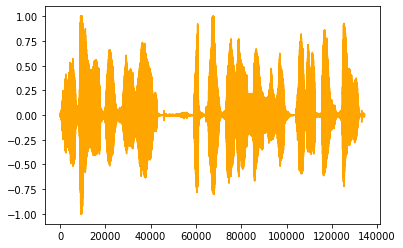

...

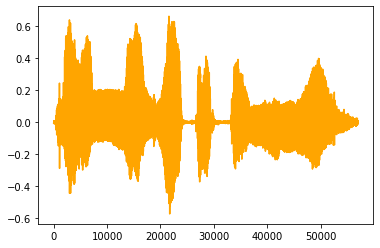

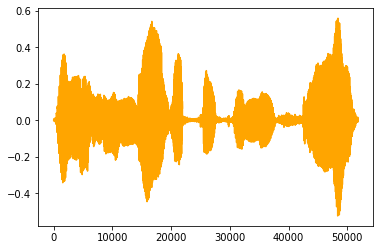

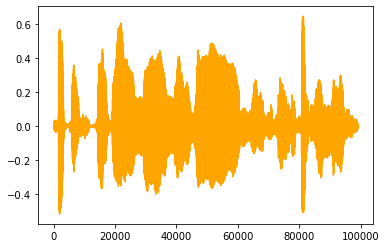

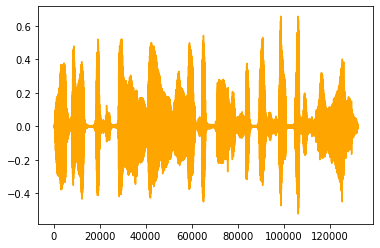

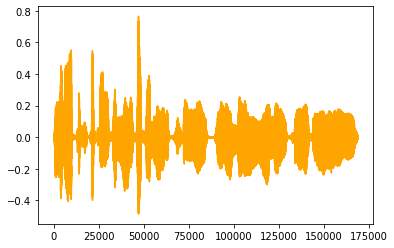

In [19]:
for single_info in dur_info:
    if single_info[1] - single_info[0] > sample_rate:
      splitted_voice = vocal_res[single_info[0]:single_info[1]]

      std_array = rolling_window(splitted_voice, std_window_size)
      end_pass, end_clip_index = end_clip(std_array, threshold = threshold)
      front_pass, front_clip_index = front_clip(std_array, threshold = threshold)
      if end_pass and front_pass:
        assert front_clip_index < len(splitted_voice) - end_clip_index, "STD array incorrect"
        clipped_splitted_voice = splitted_voice[front_clip_index:~end_clip_index]
        
        if len(clipped_splitted_voice) > sample_rate:
          plt.plot(clipped_splitted_voice, color = 'orange', label='clipped_splitted_voice')
          plt.show()
          IPython.display.display(IPython.display.Audio(np.asarray(clipped_splitted_voice).T, rate=48000))